# Часть 3 ДЗ № 1 по CMMM

<hr>

- Часть 1.1 ДЗ по [ссылке](https://github.com/shakhovak/Study-projects-in-Uni/blob/master/Diffusion_models_beginner/P1.1_HW1_Diffusion_model_simplified.ipynb)
- Часть 1.2 ДЗ по [ссылке](https://github.com/shakhovak/Study-projects-in-Uni/blob/master/Diffusion_models_beginner/P1_2_HW1_Diffusion_HF_API_standard.ipynb)
- Часть 2 ДЗ по [ссылке](https://github.com/shakhovak/Study-projects-in-Uni/blob/master/Diffusion_models_beginner/P2_HW_Stable_diff_finetune.ipynb)

<hr>

[2 балла] Анализ влияния scheduler на качество генерации

На качество генерации может влиять используемый scheduler и число шагов, поэтому в этой части домашнего задания, вам предлагается происследовать визуально как scheduler и число шагов влияют на качество генерации. Вам предлагается рассмотреть качество генерации на 10 различных числах шагов и, используя различные scheduler.

В качестве scheduler предлагается стандартный DDPM, DDIM, DPMSolver (Другие scheduler не воспрещаются). Обратите внимание, что DDIM и DPMSolver являются детерминированными scheduler, а значит результат у них должен получаться одиннаковый.

**Ожидаемый результат**:

В качестве результатов в этом пункте от вас требуется предоставить визуализации картинок в различных вариации числа шагов и scheduler и сделать выводы, какие параметры лучше использовать. Вы можете выполнить эту часть, не используя обученную выше модель, а используя стандартные pipeline StableDiffusion

# Подход к решению задачи

Для решения задачи попробуем сгенерировать модели мужских худи в стиле https://martinvalen.com/ru/svitera-i-tolstovki. Вот пример как выглядят худи на картинке ниже:

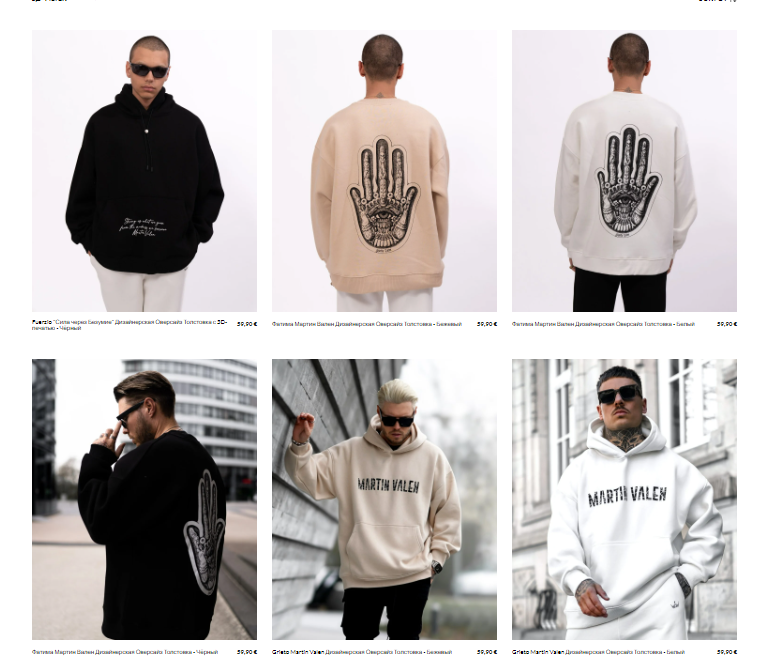

Для решения буду использовать предобученную модель https://huggingface.co/CompVis/stable-diffusion-v1-2. Это не самая последняя версия, но ее часто рекомендуют и она не такая большая как более поздние. С помощью ее пайплайна буду менять scheduler + кол-во шагов и смотреть на качестов полученных картинок.

In [1]:
import torch
from diffusers import StableDiffusionPipeline
pipeline = StableDiffusionPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16, revision='fp16')


vae\diffusion_pytorch_model.safetensors not found


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
C:\Users\Kate\anaconda3\lib\site-packages\transformers\models\clip\feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"
pipeline.to(device)

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.21.4",
  "_name_or_path": "CompVis/stable-diffusion-v1-4",
  "feature_extractor": [
    "transformers",
    "CLIPFeatureExtractor"
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [3]:
# ф-ция для вывода сгенерированных картинок

from PIL import Image

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

Для влияния кол-ва шагов на качество генерации буду менять параметр num_inference_steps для выбранного scheduler. Начну я с default значения в 50 шагов и буду увеличивать на 100 каждый раз пока не получу 10 картинок. Я не буду выбирать кол-во шагов больше 1000, так как это достаточно долго для требуемого кол-ва изображений. Попробую на этих вариантах.

For info:

- **num_inference_steps** (int, optional, defaults to 50) — The number of denoising steps. More denoising steps usually lead to a higher quality image at the expense of slower inference.

Сперва посмотрим, какие scheduler доступны для этой модели:

In [4]:
pipeline.scheduler.compatibles

[diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.utils.dummy_torch_and_torchsde_objects.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscret

In [5]:
prompt = ["black hoodie with zipper by martin valen"]

# ф-ция для генерации

def gen_images():
    
    all_images = [pipeline(prompt, num_inference_steps = i).images[0] for i in range(50, 1000, 100)]
    grid = image_grid(all_images, rows = 2, cols = 5)
    return grid

# 1. PNDMScheduler 

Pseudo numerical methods for diffusion models, uses more advanced ODE integration techniques like the Runge-Kutta and linear multi-step method.

Это дефолтный scheduler. С него и начнем и возьмем за baseline.

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/150 [00:00<?, ?it/s]

  0%|          | 0/250 [00:00<?, ?it/s]

  0%|          | 0/350 [00:00<?, ?it/s]

  0%|          | 0/450 [00:00<?, ?it/s]

  0%|          | 0/550 [00:00<?, ?it/s]

  0%|          | 0/650 [00:00<?, ?it/s]

  0%|          | 0/750 [00:00<?, ?it/s]

  0%|          | 0/850 [00:00<?, ?it/s]

  0%|          | 0/950 [00:00<?, ?it/s]

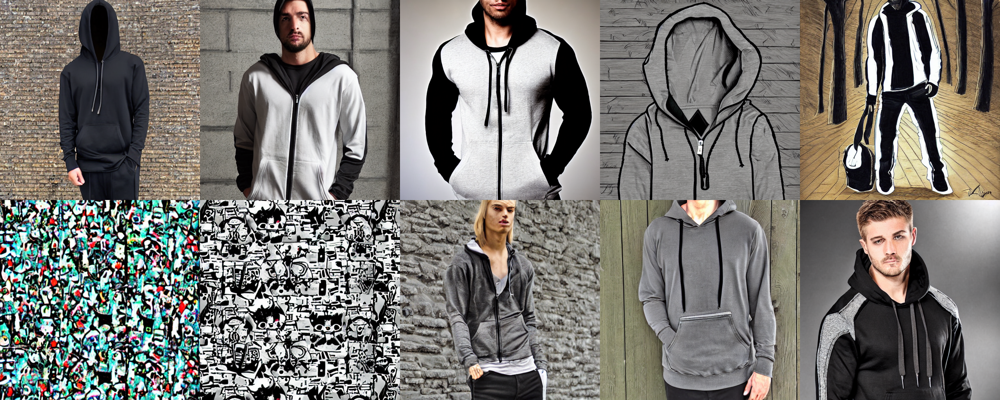

In [6]:
gen_images()

Получилось несколько абстрактных картинок, как-то не совсем то, что ожидалось. Схвачен правильный посыл коллекции (брутальная мужская мода), то сами модели - так себе. Есть искажения в лицах.

# 2.DDIMScheduler

Denoising Diffusion Implicit Models 

In [7]:
from diffusers import DDIMScheduler
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)
pipeline.scheduler

DDIMScheduler {
  "_class_name": "DDIMScheduler",
  "_diffusers_version": "0.21.4",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "clip_sample_range": 1.0,
  "dynamic_thresholding_ratio": 0.995,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "rescale_betas_zero_snr": false,
  "sample_max_value": 1.0,
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "thresholding": false,
  "timestep_spacing": "leading",
  "trained_betas": null
}

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/150 [00:00<?, ?it/s]

  0%|          | 0/250 [00:00<?, ?it/s]

  0%|          | 0/350 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/450 [00:00<?, ?it/s]

  0%|          | 0/550 [00:00<?, ?it/s]

  0%|          | 0/650 [00:00<?, ?it/s]

  0%|          | 0/750 [00:00<?, ?it/s]

  0%|          | 0/850 [00:00<?, ?it/s]

  0%|          | 0/950 [00:00<?, ?it/s]

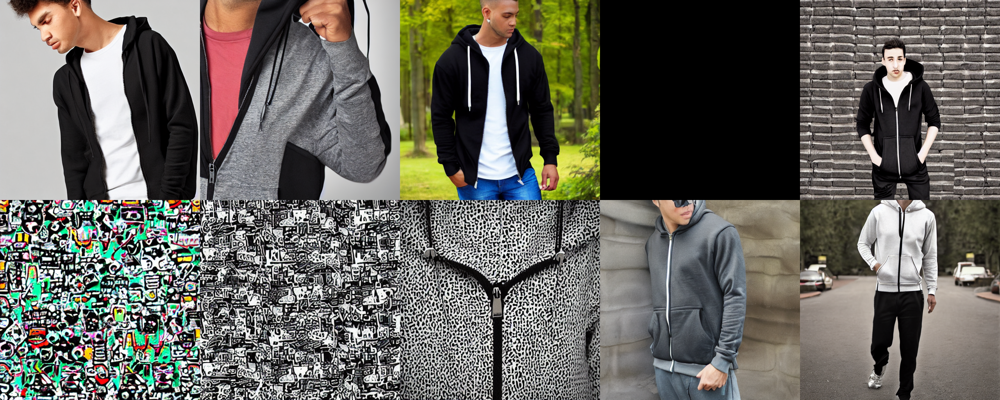

In [8]:
gen_images()

Здесь ситуация не лучше, много обстрактных картинок и не совсем правильно выполнен промт.

# 3.DPMSolverMultistepScheduler

DPMSolverMultistep is a multistep scheduler from DPM-Solver. DPMSolver (and the improved version DPMSolver++) is a fast dedicated high-order solver for diffusion ODEs with convergence order guarantee. Empirically, DPMSolver sampling with only 20 steps can generate high-quality samples, and it can generate quite good samples even in 10 steps.

In [9]:
from diffusers import DPMSolverMultistepScheduler
pipeline.scheduler = DPMSolverMultistepScheduler.from_config(pipeline.scheduler.config)
pipeline.scheduler

DPMSolverMultistepScheduler {
  "_class_name": "DPMSolverMultistepScheduler",
  "_diffusers_version": "0.21.4",
  "algorithm_type": "dpmsolver++",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "dynamic_thresholding_ratio": 0.995,
  "lambda_min_clipped": -Infinity,
  "lower_order_final": true,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "sample_max_value": 1.0,
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "solver_order": 2,
  "solver_type": "midpoint",
  "steps_offset": 1,
  "thresholding": false,
  "timestep_spacing": "linspace",
  "trained_betas": null,
  "use_karras_sigmas": false,
  "variance_type": null
}

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/150 [00:00<?, ?it/s]

  0%|          | 0/250 [00:00<?, ?it/s]

  0%|          | 0/350 [00:00<?, ?it/s]

  0%|          | 0/450 [00:00<?, ?it/s]

  0%|          | 0/550 [00:00<?, ?it/s]

  0%|          | 0/650 [00:00<?, ?it/s]

  0%|          | 0/750 [00:00<?, ?it/s]

  0%|          | 0/850 [00:00<?, ?it/s]

  0%|          | 0/950 [00:00<?, ?it/s]

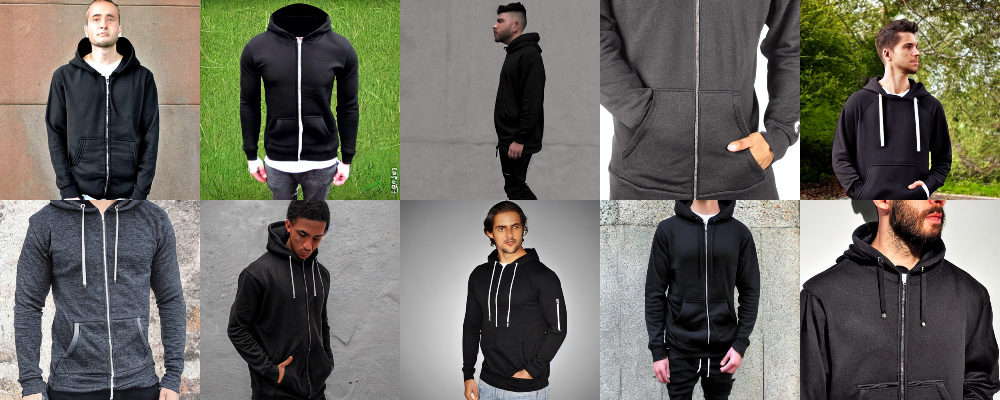

In [10]:
gen_images()

Этот scheduler, на мой взгляд, справился лучше всех. Задание выполнено максимально точно, нет абстрактных картинок

# 4. DDPMScheduler

Denoising Diffusion Probabilistic Models (DDPM) by Jonathan Ho, Ajay Jain and Pieter Abbeel proposes a diffusion based model of the same name. In the context of the 🤗 Diffusers library, DDPM refers to the discrete denoising scheduler from the paper as well as the pipeline.

In [11]:
from diffusers import DDPMScheduler
pipeline.scheduler = DDPMScheduler.from_config(pipeline.scheduler.config)
pipeline.scheduler

DDPMScheduler {
  "_class_name": "DDPMScheduler",
  "_diffusers_version": "0.21.4",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "clip_sample_range": 1.0,
  "dynamic_thresholding_ratio": 0.995,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "sample_max_value": 1.0,
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "thresholding": false,
  "timestep_spacing": "leading",
  "trained_betas": null,
  "variance_type": "fixed_small"
}

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/150 [00:00<?, ?it/s]

  0%|          | 0/250 [00:00<?, ?it/s]

  0%|          | 0/350 [00:00<?, ?it/s]

  0%|          | 0/450 [00:00<?, ?it/s]

  0%|          | 0/550 [00:00<?, ?it/s]

  0%|          | 0/650 [00:00<?, ?it/s]

  0%|          | 0/750 [00:00<?, ?it/s]

  0%|          | 0/850 [00:00<?, ?it/s]

  0%|          | 0/950 [00:00<?, ?it/s]

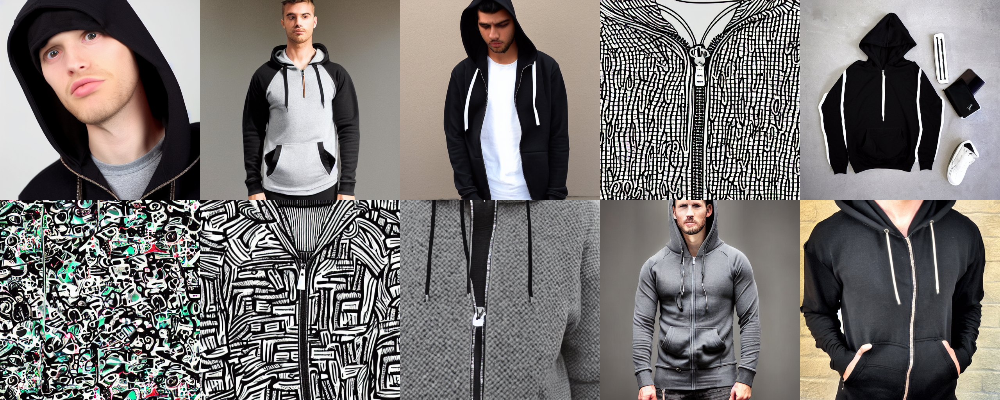

In [12]:
gen_images()

Здесь интересные картинки, но есть немного абстракции.

# Финальные выводы:

Из использованных schedulers:

- PNDMScheduler
- DDIMScheduler
- DPMSolverMultistepScheduler
- DDPMScheduler

лучшим оказался DPMSolverMultistepScheduler с наиболее устойчивыми и соответствующими промпту генерациями.

При этом кол-во шагов не дало особой разницы в результатах генерации. Я начинала генерировать от 50 шагов, в литературе и тьюториалах такое кол-во указывают как достаточное для качетсвенной генерации.

В целом генерации все моделей были достаточно далеки от референса - моделей бренда. Как раз сделать их более похожими я попыталась в части 2 этого задания, обучая stable diffusion модель на фотографиях моделей бренда.
